# Módulo 6 tarefa 3

#### 1) A base 'df_RO_2019.csv' contém dados do sistema de nascidos vivos do DataSUS, cujo dicionário de dados está no arquivo 'Estrutura_df_para_CD.pdf'. Carregue esse arquivo.

In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
df = pd.read_csv('./SINASC_RO_2019.csv',na_values=('NA','',' ','nan','NAN','na'))
def reload_df(df):
    df = pd.read_csv('./SINASC_RO_2019.csv',na_values=('NA','',' ','nan','NAN','na'))
    print(df.shape)
    return df
df=reload_df(df)

(27028, 69)


#### 2) Categorize a variável APGAR5 conforme as seguintes quebras:

- 0 a 3: 'asfixia grave'
- 4 a 5: 'asfixia moderada'
- 6 a 7: 'asfixia leve'
- 8 a 10: 'normal'

In [4]:
df.loc[(df['APGAR5'] == 10) | (df['APGAR5'] >= 8), 'faixa_oms' ] = 'normal'
df.loc[(df['APGAR5'] == 7)  | (df['APGAR5'] == 6), 'faixa_oms' ] = 'asfixia_leve'
df.loc[(df['APGAR5'] == 5)  | (df['APGAR5'] == 4), 'faixa_oms' ] = 'asfixia_moderada'
df.loc[(df['APGAR5'] <= 3)  | (df['APGAR5'] == 0), 'faixa_oms' ] = 'asfixia_severa'
df.dropna(subset='APGAR5', inplace=True) 
df['faixa_oms'].value_counts()
na_values = df.isna().sum()
print(na_values)


ORIGEM         0
CODESTAB      66
CODMUNNASC     0
LOCNASC        0
IDADEMAE       0
              ..
munResLat      1
munResLon      1
munResAlt      1
munResArea     1
faixa_oms      0
Length: 70, dtype: int64


#### 3) Monte um gráfico comparando a distribuição de APGAR5 por sexo para cada grupo de tempo de gestação (GESTACAO).

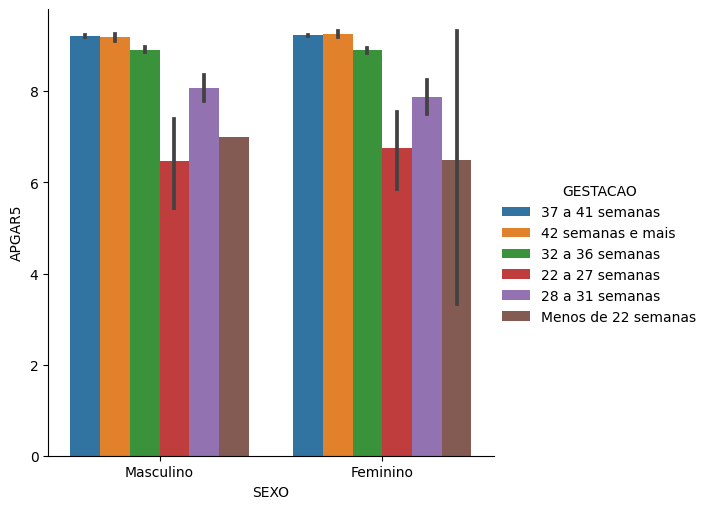

In [3]:
sns.catplot(x='SEXO'
            , y='APGAR5'
            , hue = 'GESTACAO'
            , kind='bar'
            , data=df
           )

####  4) Monte uma tabela cruzada com APGAR5 nas colunas e GESTACAO nas linhas

In [10]:
freq = pd.crosstab(df['GESTACAO'], df['APGAR5'])
freq

APGAR5,0.0,1.0,2.0,3.0,4.0,5.0,6.0,7.0,8.0,9.0,10.0
GESTACAO,,,,,,,,,,,
22 a 27 semanas,7,0,8,6,1,0,2,10,24,19,8
28 a 31 semanas,0,0,2,1,5,7,7,11,61,55,13
32 a 36 semanas,2,2,2,2,8,11,17,56,362,1307,465
37 a 41 semanas,5,20,3,5,7,21,45,151,1417,13565,7284
42 semanas e mais,1,0,0,0,0,1,1,5,44,423,223
Menos de 22 semanas,1,0,1,0,0,0,0,1,0,3,1


####  5) Da tabela cruzada do intem anterior, calcule os percentuais de linha. Ou seja, a distribuição da variável APGAR5 para cada classe de GESTACAO dado.

In [11]:
freq_pctlin = freq.div(freq.sum(axis = 1), axis = 0)
freq_pctlin

APGAR5,0.0,1.0,2.0,3.0,4.0,5.0,6.0,7.0,8.0,9.0,10.0
GESTACAO,,,,,,,,,,,
22 a 27 semanas,0.082353,0.000000,0.094118,0.070588,0.011765,0.000000,0.023529,0.117647,0.282353,0.223529,0.094118
28 a 31 semanas,0.000000,0.000000,0.012346,0.006173,0.030864,0.043210,0.043210,0.067901,0.376543,0.339506,0.080247
32 a 36 semanas,0.000895,0.000895,0.000895,0.000895,0.003581,0.004924,0.007610,0.025067,0.162041,0.585049,0.208147
37 a 41 semanas,0.000222,0.000888,0.000133,0.000222,0.000311,0.000932,0.001998,0.006704,0.062913,0.602273,0.323403
42 semanas e mais,0.001433,0.000000,0.000000,0.000000,0.000000,0.001433,0.001433,0.007163,0.063037,0.606017,0.319484
Menos de 22 semanas,0.142857,0.000000,0.142857,0.000000,0.000000,0.000000,0.000000,0.142857,0.000000,0.428571,0.142857


####  6) Os médicos costumam classificar parto prematuro quando a gestação tem menos que 37 semanas. Faça um gráfico de barras da tabela cruzada acima e conclua se você acha que este conjunto de dados corrobora ou não com a afirmação dos médicos.

<Axes: xlabel='GESTACAO'>

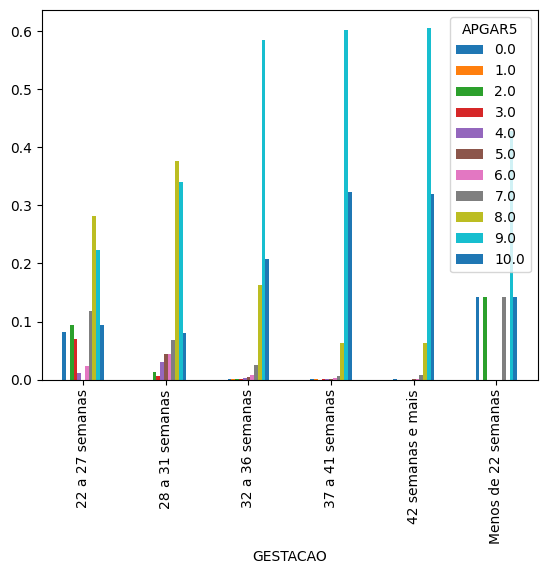

In [12]:
freq_pctlin.plot.bar()

In [19]:
columns = ['PESO', 'APGAR5']
df_umap=df[columns]
df_umap.head()

,PESO,APGAR5
0,3685,10.0
1,3055,9.0
2,3460,10.0
3,2982,10.0
4,3310,10.0


#### 7) Veja se há relação entre APGAR5 e o peso do bebê. Isso pode ser feito de diversas formas. Fique à vontade para escolher a melhor maneira na sua opinião, ou até testar mais de um dos gráficos que vimos. Fique à vontade também para consultar a documentação e utilizar algum outro recurso se achar conveniente.

In [7]:
import pandas as pd
import numpy as np
import umap
import matplotlib.pyplot as plt
df = reload_df(df)
df.dropna(subset='PESO',inplace=True)
df.dropna(subset='APGAR5',inplace=True)
df_umap=df[['PESO','APGAR5']]

# Initialize UMAP
umap_model = umap.UMAP(n_components=2, 
                       random_state=42,
                       n_neighbors=100,
                       init="spectral",
                       metric="manhattan",
                       spread=50,
                       min_dist=10)

# Fit and transform the data
umap_embedding = umap_model.fit_transform(df_umap.select_dtypes('number'))

# Create a DataFrame with UMAP results
umap_df = pd.DataFrame(umap_embedding, 
                       columns=['UMAP1','UMAP2'])
umap_df.head()

(27028, 69)


c:\Users\coimb\AppData\Local\Programs\Python\Python310\lib\site-packages\umap\umap_.py:1393: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
c:\Users\coimb\AppData\Local\Programs\Python\Python310\lib\site-packages\umap\umap_.py:1943: UserWarning: n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
c:\Users\coimb\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\manifold\_spectral_embedding.py:301: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(
c:\Users\coimb\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\manifold\_spectral_embedding.py:427: UserWarning: Exited at iteration 18 with accuracies 
[5.83660057e-12 7.24887519e-06 1.70256673e-06 3.48090807e-06]
not reaching the requested tolerance 5.2493809158795095e-06

,UMAP1,UMAP2
0,-16.657286,-9.315263
1,63.028931,-40.249172
2,81.531410,91.611694
3,10.105157,8.510902
4,54.885399,129.250626


In [8]:
df = reload_df(df)
excluir_do_umap=['ORIGEM', 'CODANOMAL', 'DTRECORIGA','DIFDATA', 'STDNNOVA' ,'STDNEPIDEM','CODPAISRES', 'CONTADOR','munResStatus', 'munResTipo']
dummies=['CODESTAB', 'CODMUNNASC', 'LOCNASC', 'ESTCIVMAE', 'ESCMAE', 'CODOCUPMAE', 'GESTACAO', 'GRAVIDEZ', 'PARTO', 'SEXO', 'RACACOR', 'IDANOMAL', 'NUMEROLOTE', 'VERSAOSIST', 'NATURALMAE', 'CODMUNNATU', 'CODUFNATU', 'ESCMAE2010', 'SERIESCMAE', 'RACACORMAE', 'QTDGESTANT', 'QTDPARTNOR', 'QTDPARTCES', 'TPROBSON', 'PARIDADE', 'KOTELCHUCK', 'MESPRENAT', 'TPAPRESENT', 'STTRABPART', 'STCESPARTO', 'TPNASCASSI', 'TPFUNCRESP', 'TPDOCRESP', 'munResNome', 'munResUf']
timeseries=['DTNASC', 'HORANASC', 'DTCADASTRO', 'DTRECEBIM', 'DTNASCMAE', 'DTULTMENST', 'DTDECLARAC']
numerics=['IDADEMAE', 'QTDFILVIVO', 'QTDFILMORT', 'CONSULTAS', 'APGAR1', 'CONSPRENAT', 'APGAR5', 'PESO', 'IDADEPAI', 'munResLat', 'munResLon', 'munResAlt', 'munResArea']

df.drop(columns=excluir_do_umap, inplace=True)

for dummie in dummies:    
    df[dummie] = pd.Categorical(df[dummie])
    df[dummie] = df[dummie].cat.codes
    
for times in timeseries:    
    df[times] = pd.Categorical(df[times])
    df[times] = df[times].cat.codes



(27028, 69)


In [9]:

for times in timeseries:
    print(f'Coluna {times}: {df[times].loc[0]}')
    



Coluna DTNASC: 49
Coluna HORANASC: 979
Coluna DTCADASTRO: 45
Coluna DTRECEBIM: 22
Coluna DTNASCMAE: 5740
Coluna DTULTMENST: 203
Coluna DTDECLARAC: 220


In [10]:
df.isna().sum()

na_vect = ['QTDFILVIVO', 'QTDFILMORT', 'APGAR1', 'APGAR5', 'IDADEPAI', 'SEMAGESTAC', 'TPMETESTIM', 'CONSPRENAT', 'ESCMAEAGR1', 'munResLat', 'munResLon', 'munResAlt', 'munResArea']    
for na in na_vect:
    df[na] = df[na].fillna(df[na].mean())     

df.isna().sum()

CODESTAB      0
CODMUNNASC    0
LOCNASC       0
IDADEMAE      0
ESTCIVMAE     0
ESCMAE        0
CODOCUPMAE    0
QTDFILVIVO    0
QTDFILMORT    0
CODMUNRES     0
GESTACAO      0
GRAVIDEZ      0
PARTO         0
CONSULTAS     0
DTNASC        0
HORANASC      0
SEXO          0
APGAR1        0
APGAR5        0
RACACOR       0
PESO          0
IDANOMAL      0
DTCADASTRO    0
NUMEROLOTE    0
VERSAOSIST    0
DTRECEBIM     0
NATURALMAE    0
CODMUNNATU    0
CODUFNATU     0
ESCMAE2010    0
SERIESCMAE    0
DTNASCMAE     0
RACACORMAE    0
QTDGESTANT    0
QTDPARTNOR    0
QTDPARTCES    0
IDADEPAI      0
DTULTMENST    0
SEMAGESTAC    0
TPMETESTIM    0
CONSPRENAT    0
MESPRENAT     0
TPAPRESENT    0
STTRABPART    0
STCESPARTO    0
TPNASCASSI    0
TPFUNCRESP    0
TPDOCRESP     0
DTDECLARAC    0
ESCMAEAGR1    0
TPROBSON      0
PARIDADE      0
KOTELCHUCK    0
munResNome    0
munResUf      0
munResLat     0
munResLon     0
munResAlt     0
munResArea    0
dtype: int64

In [11]:
# Initialize UMAP
umap_model = umap.UMAP(n_components=2, 
                       random_state=42,
                       n_neighbors=200,
                       init="spectral",
                       metric="manhattan",
                       spread=5,
                       min_dist=1)

# Fit and transform the data
umap_embedding = umap_model.fit_transform(df)

# Create a DataFrame with UMAP results
umap_df = pd.DataFrame(umap_embedding)

c:\Users\coimb\AppData\Local\Programs\Python\Python310\lib\site-packages\umap\umap_.py:1393: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
c:\Users\coimb\AppData\Local\Programs\Python\Python310\lib\site-packages\umap\umap_.py:1943: UserWarning: n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


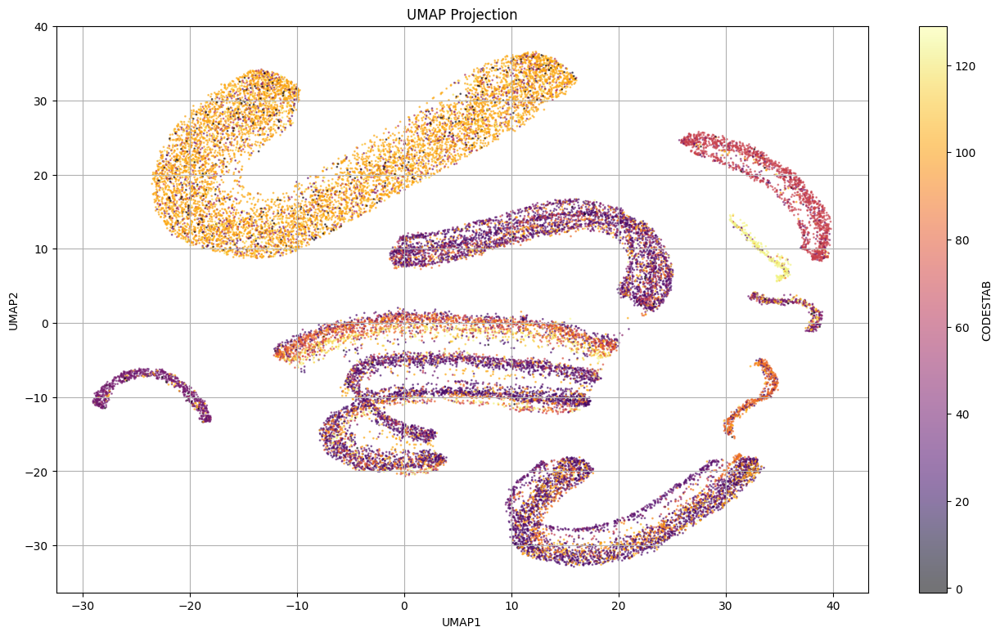

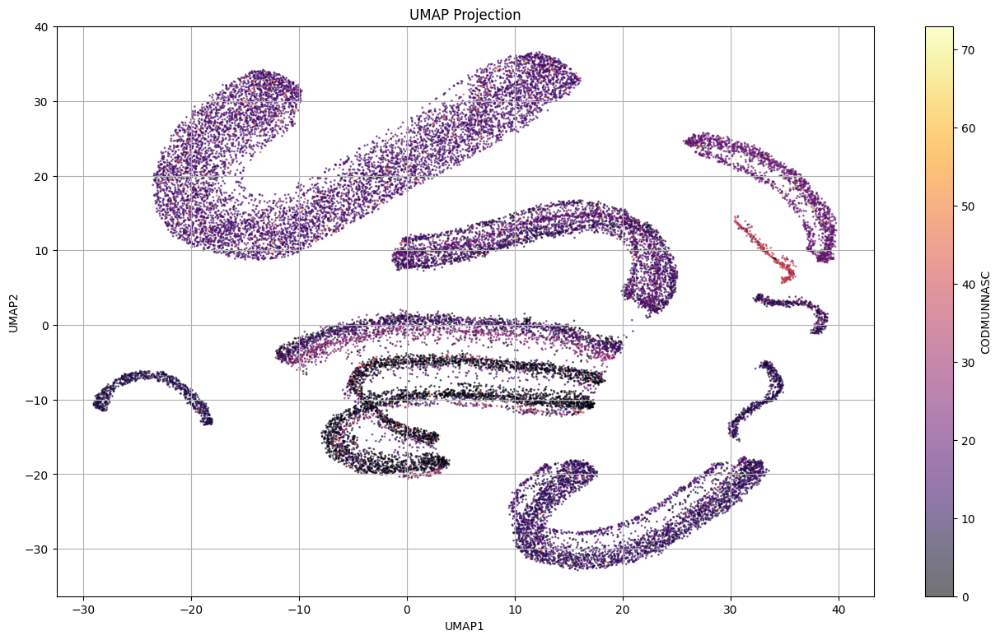

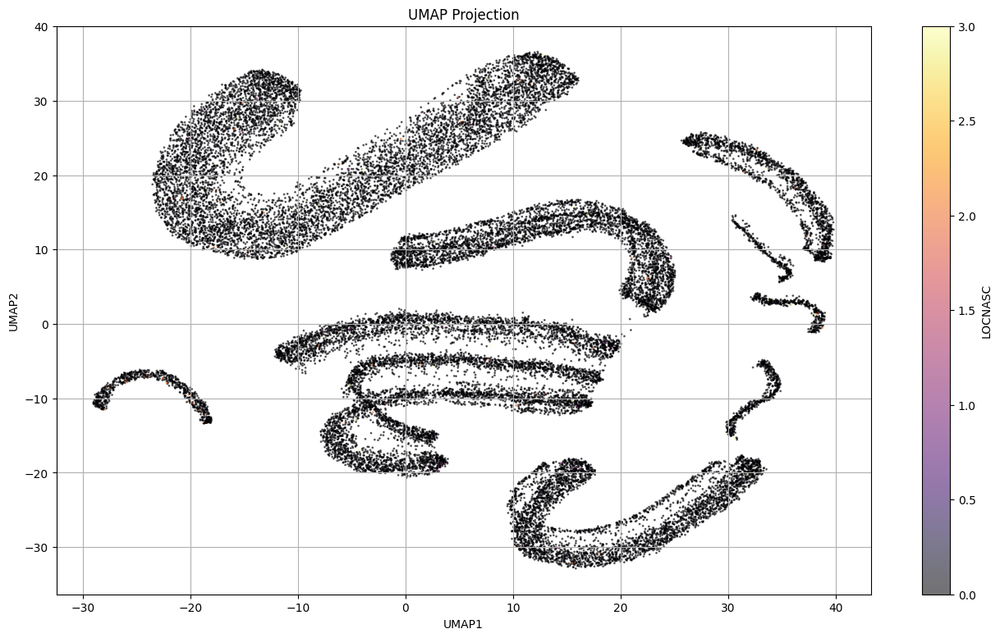

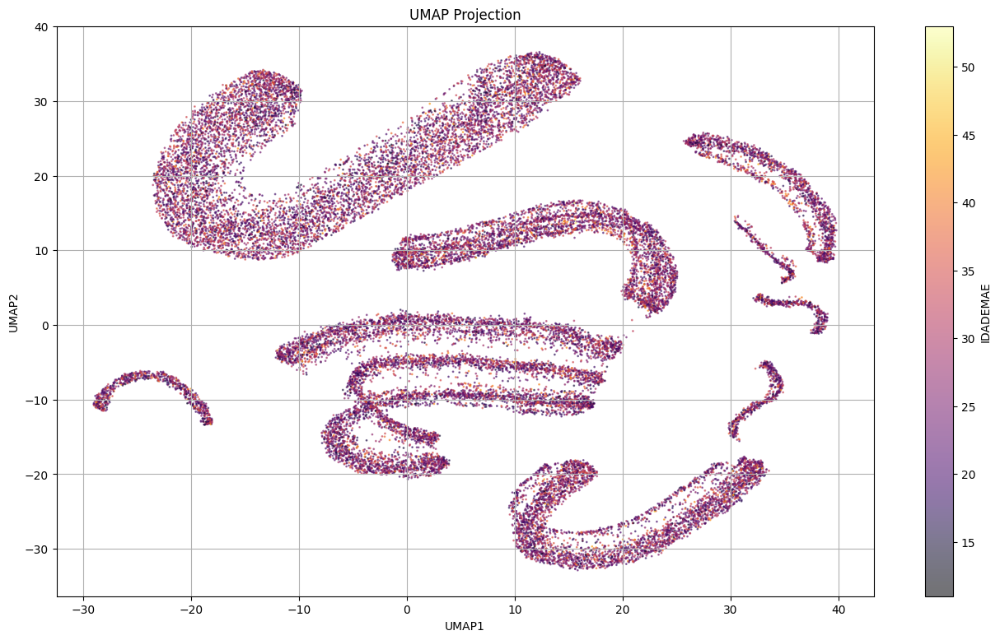

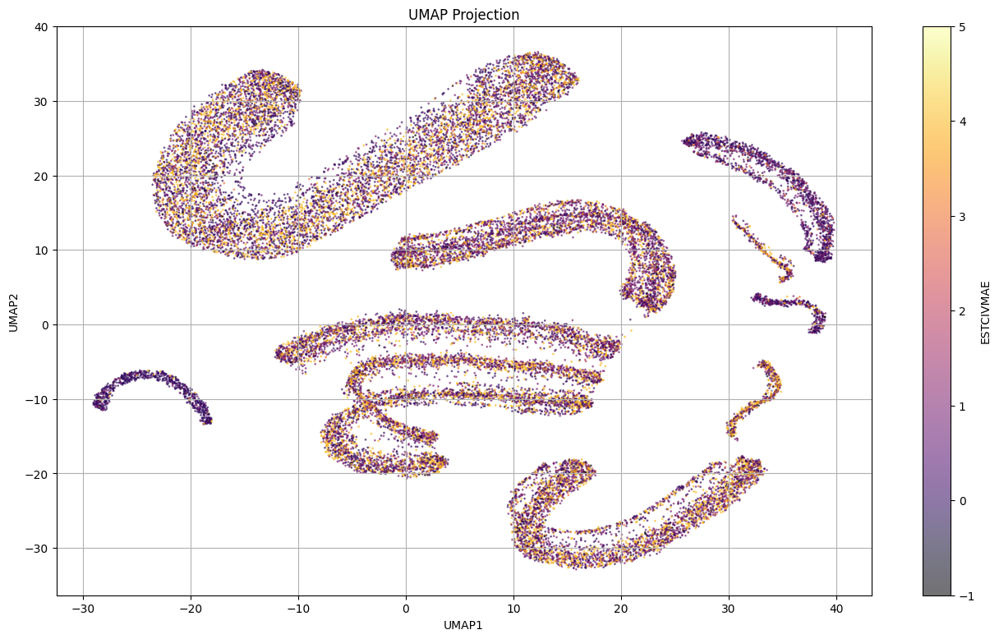

...

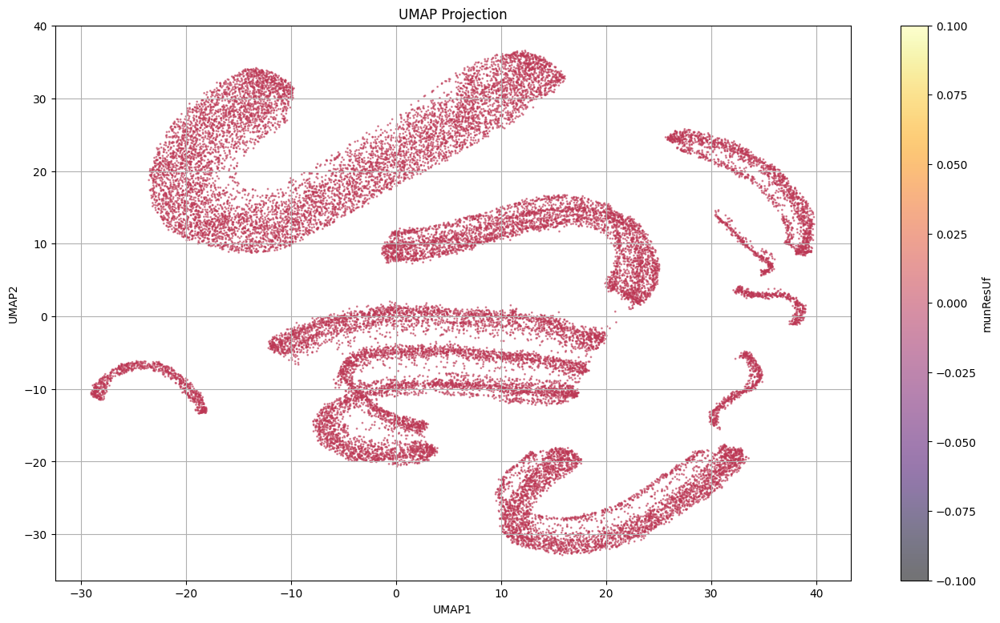

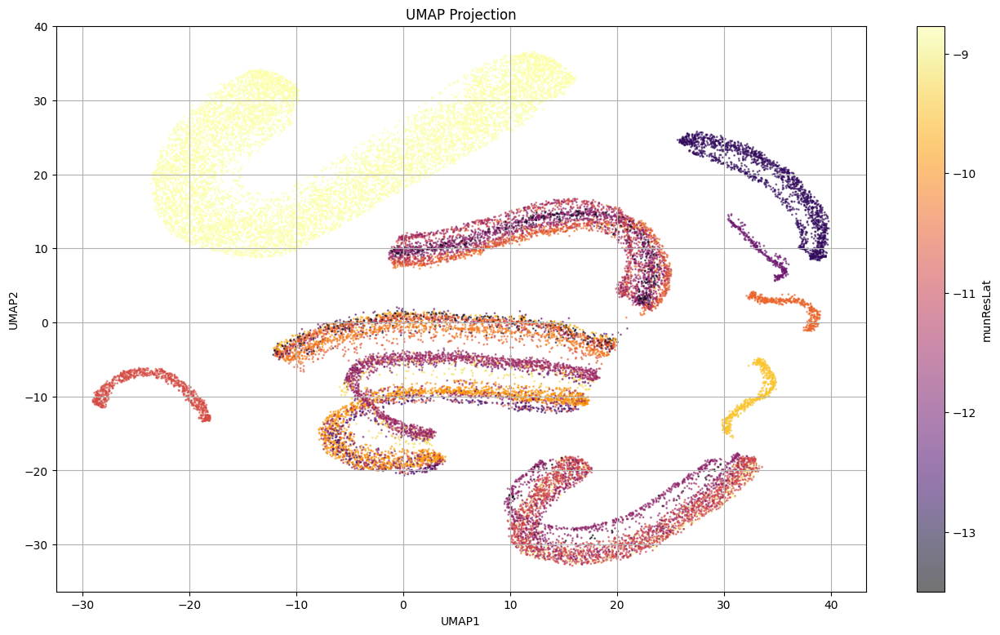

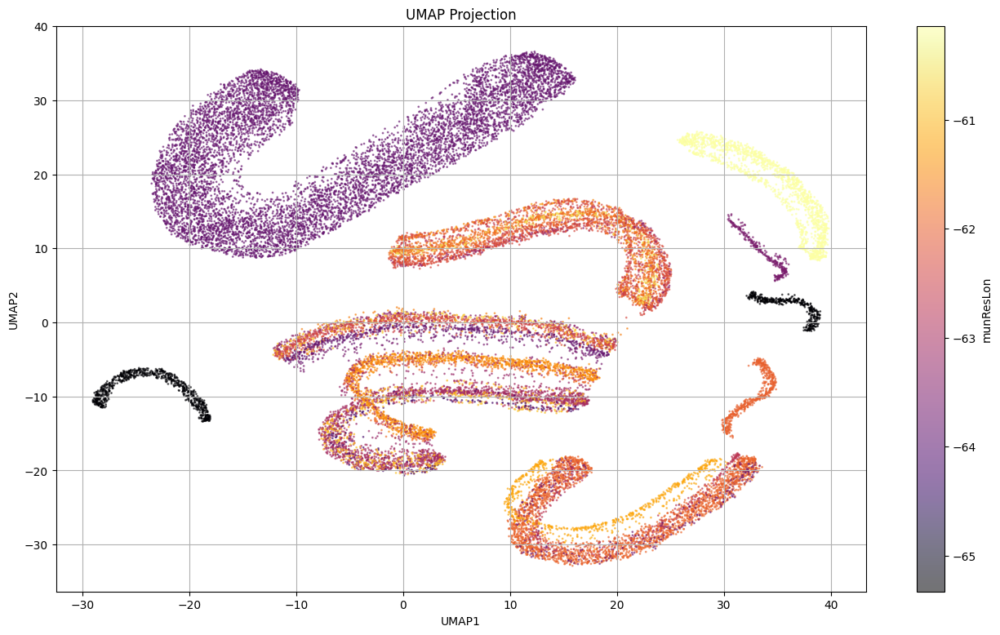

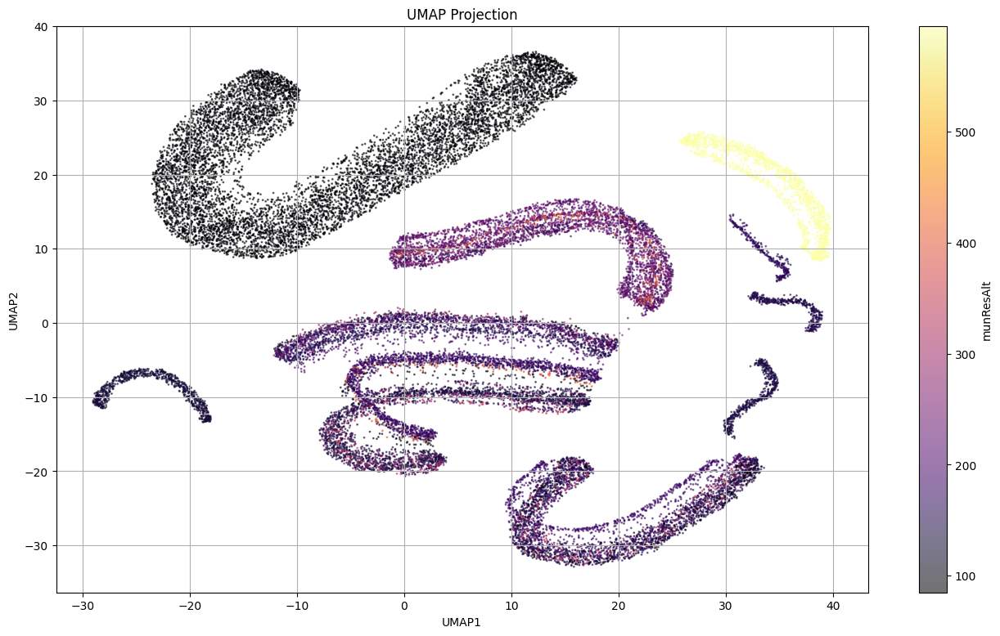

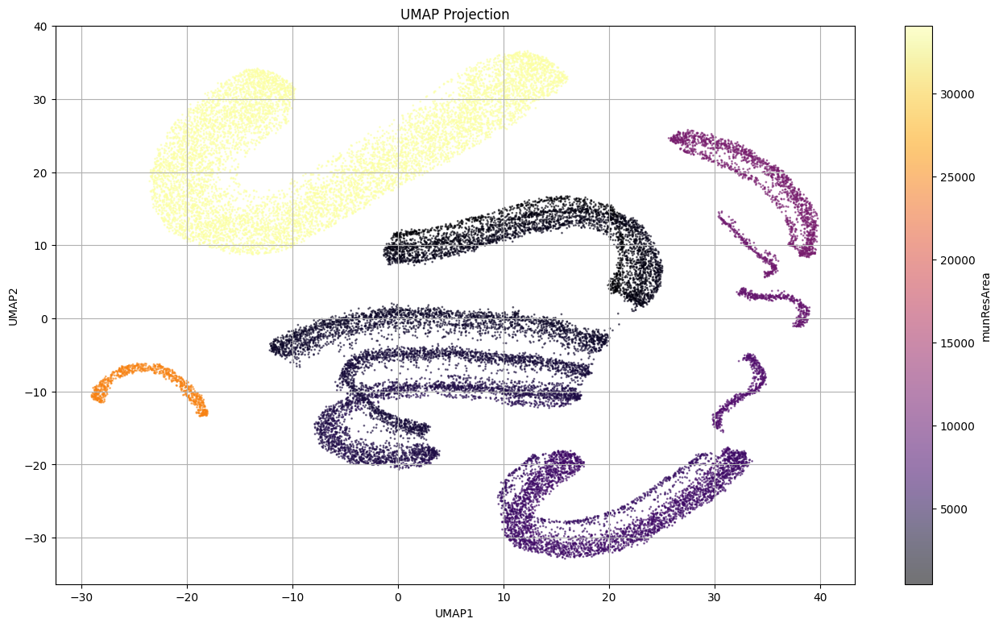

In [19]:
df.columns.tolist()
for coluna in df.columns.tolist():
    colors = df[coluna]

    # Normalize the colors for better visualization
    norm = plt.Normalize(colors.min(), colors.max())
    cmap = plt.get_cmap('inferno')  # You can choose other colormaps like 'plasma', 'inferno'
    plt.figure(figsize=(16, 9))
    scatter=plt.scatter(x=umap_embedding[0:,0],
                        y=umap_embedding[0:,1], 
                        c=colors,
                        cmap=cmap,
                        norm=norm, 
                        s=1, 
                        alpha=0.55)
    plt.title('UMAP Projection')
    plt.xlabel('UMAP1')
    plt.ylabel('UMAP2')
    plt.colorbar(scatter, 
                label=coluna)  # Add color bar to show the scale
    plt.grid(True)
    plt.show()
    